# Projeto de análise de dados de acidentes na cidade de Porto Alegre - RS

In [220]:
# Importando base de dados

import pandas as pd

base = pd.read_csv('/content/drive/MyDrive/Colab Notebooks/Projeto_acidentes/cat_acidentes.csv', sep=';').dropna(subset=['longitude', 'latitude'])

# Tratando colunas de datas

base['data'] = pd.to_datetime(base['data'])

base['dia'] = base['data'].dt.day
base['mes'] = base['data'].dt.month
base['ano'] = base['data'].dt.year

base = base.drop(['data_extracao', 'data', 'idacidente'], axis=1)[base['ano'] <= 2024]


display(base.info())

display(base['ano'].value_counts())

<class 'pandas.core.frame.DataFrame'>
Index: 62742 entries, 0 to 72948
Data columns (total 34 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   predial1    60404 non-null  float64
 1   queda_arr   62742 non-null  float64
 2   feridos     62742 non-null  int64  
 3   feridos_gr  62742 non-null  int64  
 4   mortes      62742 non-null  int64  
 5   morte_post  62742 non-null  int64  
 6   fatais      62742 non-null  int64  
 7   auto        62742 non-null  int64  
 8   taxi        62742 non-null  int64  
 9   lotacao     62742 non-null  int64  
 10  onibus_urb  62742 non-null  int64  
 11  onibus_met  62742 non-null  int64  
 12  onibus_int  62742 non-null  int64  
 13  caminhao    62742 non-null  int64  
 14  moto        62742 non-null  int64  
 15  carroca     62742 non-null  int64  
 16  bicicleta   62742 non-null  int64  
 17  outro       62742 non-null  int64  
 18  cont_vit    62742 non-null  int64  
 19  ups         62742 non-null  in

None

,count
ano,
2023,14569
2022,13326
2019,12444
2021,11700
2024,7807
2020,2896


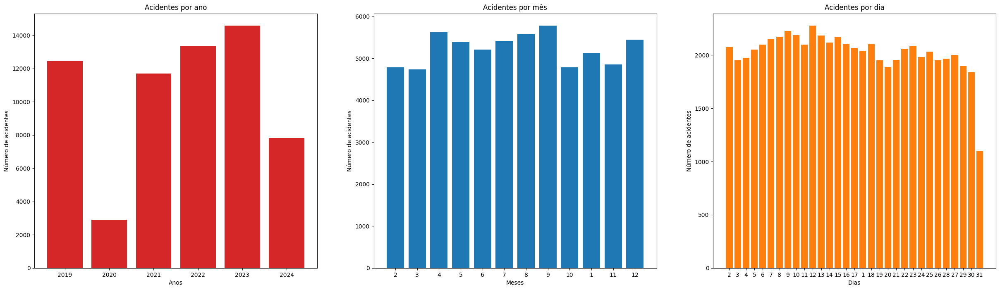

In [221]:
# Criando visualização de gráfico de barras da coluna de ano

import matplotlib.pyplot as plt

contagem_anos = base.ano.value_counts()
contagem_meses = base.mes.value_counts(sort=False, ascending=False)
contagem_dias = base.dia.value_counts(sort=False, ascending=False)

fig, ax = plt.subplots(1,3, figsize=(30, 8))

ax[0].bar(contagem_anos.index, contagem_anos.values, color='tab:red')
ax[0].set_title('Acidentes por ano')
ax[0].set_xlabel('Anos')
ax[0].set_ylabel('Número de acidentes')

meses = list(range(1,13))
ax[1].bar(contagem_meses.index, contagem_meses.values, tick_label=meses, color='tab:blue')
ax[1].set_title('Acidentes por mês')
ax[1].set_xlabel('Meses')
ax[1].set_ylabel('Número de acidentes')

dias = list(range(1,32))
ax[2].bar(contagem_dias.index, contagem_dias.values, tick_label=dias, color='tab:orange')
ax[2].set_title('Acidentes por dia')
ax[2].set_xlabel('Dias')
ax[2].set_ylabel('Número de acidentes')

fig.show()

<ipython-input-222-008657dc3b25>:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cruzamentos['cruzamento'] = cruzamentos['log1'] + ' & ' + cruzamentos['log2']


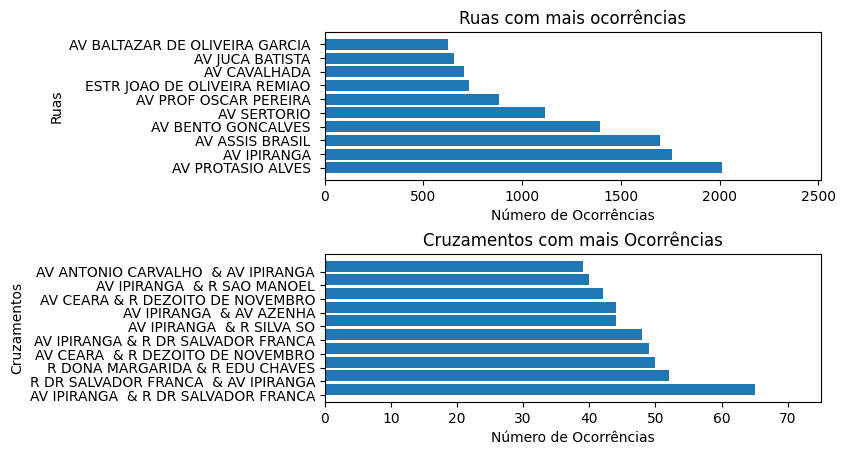

In [222]:
# Criando nova base a partir de 'log1' e 'log2'
base_ruas = base[['log1', 'log2']]

# Removendo 'log1' e 'log2' da base original
base = base.drop(['log1', 'log2'], axis=1)

# Contando as ocorrências das ruas em 'log1'
contagem_ruas = base_ruas['log1'].value_counts().head(10)

# Criando o gráfico de barras horizontais
fig, ax = plt.subplots(2, 1)

ax[0].barh(contagem_ruas.index, contagem_ruas.values)
ax[0].set_title('Ruas com mais ocorrências')
ax[0].set_xlabel('Número de Ocorrências')  # Rótulo do eixo x
ax[0].set_ylabel('Ruas')  # Rótulo do eixo y

# Ajustando o intervalo do eixo x
ax[0].set_xlim(0, contagem_ruas.values.max() + 500)  # Ajuste o valor conforme necessário

# Analisando acidentes em cruzamentos

cruzamentos = base_ruas[~base_ruas['log2'].isnull() & ~base_ruas['log1'].isnull()]

# Criando uma nova coluna que representa o cruzamento
cruzamentos['cruzamento'] = cruzamentos['log1'] + ' & ' + cruzamentos['log2']

# Contando as ocorrências de cada cruzamento
contagem_cruzamentos = cruzamentos['cruzamento'].value_counts().head(10)

# Criando o gráfico de barras
ax[1].barh(contagem_cruzamentos.index, contagem_cruzamentos.values, align='edge')
ax[1].set_title('Cruzamentos com mais Ocorrências')
ax[1].set_xlabel('Número de Ocorrências')
ax[1].set_ylabel('Cruzamentos')
ax[1].set_xlim(0, max(contagem_cruzamentos.values) + 10)

fig.subplots_adjust(hspace=0.5)

fig.show()


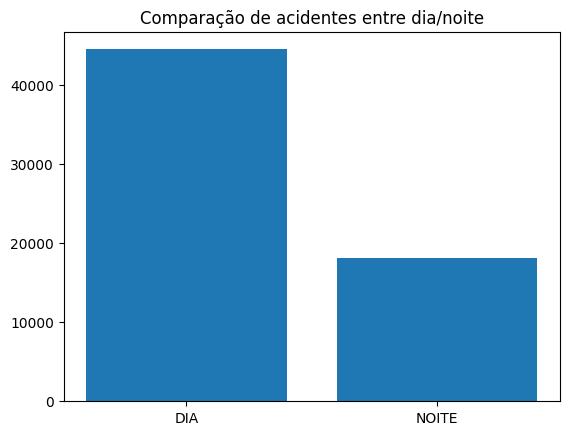

In [223]:
# Verificando a influência do horário do dia na ocorrência de acidentes

contagem_dia = base['noite_dia'].value_counts()

plt.bar(contagem_dia.index, contagem_dia.values)
plt.title('Comparação de acidentes entre dia/noite')

plt.show()

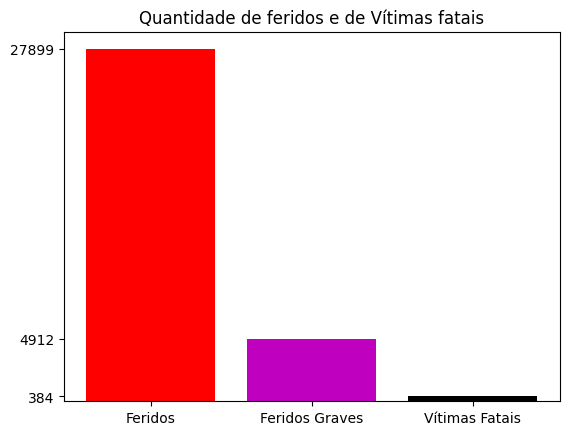

In [224]:
# Contagem de feridos, mortes

contagem_feridos = base['feridos'].values.sum()
contagem_feridos_gr = base['feridos_gr'].values.sum()
contagem_fatais = base['fatais'].values.sum()

plt.bar(['Feridos', 'Feridos Graves', 'Vítimas Fatais'], [contagem_feridos, contagem_feridos_gr, contagem_fatais], color=['r', 'm', 'k'])
plt.yticks([contagem_feridos, contagem_feridos_gr, contagem_fatais])
plt.title('Quantidade de feridos e de Vítimas fatais')
plt.show()


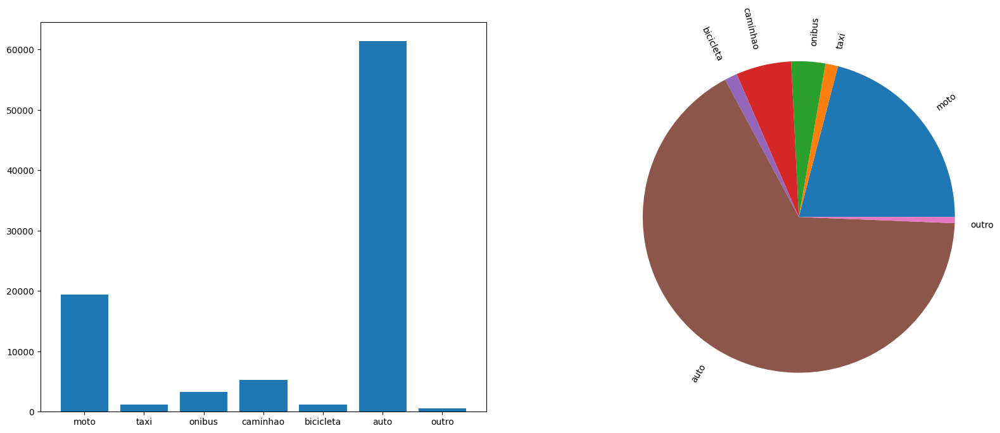

In [225]:
# Visualizando automoveis envolvidos nos acidentes

contagem_motos = base['moto'].values.sum()
contagem_taxi = base['taxi'].values.sum()
contagem_bus = base['onibus_urb'].sum() + base['onibus_int'].sum() + base['onibus_met'].values.sum()
contagem_caminhao = base['caminhao'].values.sum()
contagem_bicicleta = base['bicicleta'].values.sum()
contagem_auto = base['auto'].values.sum() - contagem_motos - contagem_taxi - contagem_bus - contagem_caminhao
contagem_outro = base['outro'].values.sum() + base['carroca'].values.sum() + base['lotacao'].values.sum()

contagens = [contagem_motos, contagem_taxi, contagem_bus, contagem_caminhao, contagem_bicicleta, contagem_auto, contagem_outro]
colunas = ['moto', 'taxi', 'onibus', 'caminhao', 'bicicleta', 'auto', 'outro']
fig, ax = plt.subplots(1,2, figsize=(20, 8))
ax[0].bar(colunas, contagens)
ax[1].pie(contagens, labels=colunas, radius=1, rotatelabels=True)

fig.show()


In [226]:
# Criando mapa de calor baseado nas localizações dos acidentes
import folium
from folium.plugins import HeatMap

mapa = folium.Map(location=[-30.1, -51.15], zoom_start=13)
coordenadas = list(zip(base.latitude, base.longitude))
mapa_calor = HeatMap(coordenadas, radius=7, blur=5)
mapa.add_child(mapa_calor)

mapa

In [227]:
# Criando mapa de clusters
from folium.plugins import MarkerCluster

mapa = folium.Map(location=[-30.1, -51.15], zoom_start=13)
mapa_cluster = MarkerCluster(coordenadas)
mapa.add_child(mapa_cluster)

mapa